In [1]:
'''
The collection of Real Property Taxes in Davidson County is the responsibility of the Office of the Trustee.

The Property Assessor places the appraised value on residential and commercial properties. The Trustee accepts the
Certified Real Property Tax Roll from the Property Assessor in September each year for collection.

Property tax statements are generated from the Tax Roll and mailed the first week of October each year.
'''
print()

In [2]:
from shapely.geometry import Point
from datetime import datetime
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
%matplotlib inline
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
import numpy as np

In [3]:
NAL = pd.read_csv('../data/file.csv')
NAL.head(10)

C:\Users\Scott\anaconda3\envs\geospatial\lib\site-packages\IPython\core\interactiveshell.py:3444: DtypeWarning: Columns (13,18) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,...,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
0,1,001 00 0 001.00,00100000100,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE RAY & HELEN F.",12/05/2006,DC-20110805 0060547,7500.0,...,1733,0,na,13169,3292,0,3292,0.25,NaN,0.25
1,2,001 00 0 002.00,00100000200,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE R.",05/17/1983,DB-00006058 0000985,12500.0,...,2274,0,na,20239,5060,0,5060,0.25,NaN,0.25
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",03/27/1989,DB-00007802 0000048,270000.0,...,18023,0,na,31000,0,0,0,0.00,NaN,0.00
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,small parcel,0,na,15400,0,0,0,0.00,NaN,0.00
5,5,002 00 0 001.00 002,00200000100002,NaN,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,...,16493,0,na,34800,0,0,0,0.00,NaN,0.00
6,6,002 00 0 002.00,00200000200,10.0,37010202.0,RIDGETOP (GSD),"MUELLER, EDWARD DUANE, JR.",09/05/2014,DB-20140909 0082428,50000.0,...,small parcel,33000,na,63000,7500,8250,15750,0.25,0.25,0.25
7,7,002 00 0 003.00,00200000300,10.0,37010202.0,RIDGETOP (GSD),"SHRUM FAMILY HOLDINGS, INC.",12/22/2010,DC-20120106 0001670,95000.0,...,18006,142400,74,198400,14000,35600,49600,0.25,0.25,0.25
8,8,002 00 0 007.00,00200000700,10.0,37010202.0,RIDGETOP (GSD),"SUMMERS, SALLY C.",11/24/2004,DB-20041201 0142810,115000.0,...,19455,180400,123,230400,12500,45100,57600,0.25,0.25,0.25
9,9,002 00 0 008.00,00200000800,10.0,37010202.0,RIDGETOP (GSD),"ROGERS, KATHRYN",02/03/2016,AF-20170210 0014262,NaN,...,21453,0,na,25100,6275,0,6275,0.25,NaN,0.25


In [4]:
pd.set_option("display.max_columns", 50)
pd.set_option("display.max_rows", None)
pd.set_option("display.max_colwidth", 60)
NAL.head()

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
0,1,001 00 0 001.00,00100000100,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE RAY & HELEN F.",12/05/2006,DC-20110805 0060547,7500.0,204 SAVANNAH EAST CT,SPRINGFIELD,TN,37172,US,0 WHITES CREEK PIKE,WHITES CREEK PIKE,0,NaN,JOELTON,TN,37080,36.389204,-86.900090,W SIDE WHITES CREEK PIKE N OF COOPERTOWN RD,DB-00000137 0000216,01/01/2008,7.60,0,0,0,GREENBELT/RES\r\nGRRENBELT/RES,A,AGR 25%,13169,1733,0,na,13169,3292,0,3292,0.25,NaN,0.25
1,2,001 00 0 002.00,00100000200,1.0,37010103.0,GENERAL SERVICES DISTRICT,"THAXTON, JESSE R.",05/17/1983,DB-00006058 0000985,12500.0,204 SAVANNAH EAST CT,SPRINGFIELD,TN,37172,US,8538 WHITES CREEK PIKE,WHITES CREEK PIKE,8538,NaN,JOELTON,TN,37080,36.389417,-86.898070,E SIDE WHITES CREEK PIKE N OF COOPERTOWN RD.,DB-00000155 0000282,01/06/1972,8.90,0,0,0,GREENBELT/RES\r\nGRRENBELT/RES,A,AGR 25%,20239,2274,0,na,20239,5060,0,5060,0.25,NaN,0.25
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",03/27/1989,DB-00007802 0000048,270000.0,8661 WHITES CREEK PIKE,JOELTON,TN,37080,US,8663 WHITES CREEK PIKE,WHITES CREEK PIKE,8663,NaN,JOELTON,TN,37080,36.389238,-86.904732,ASSESSED IN ROBERTSON COUNTY,DB-00007326 0000026,08/14/1987,1.72,0,0,0,VACANT RURAL LAND,L,ASS 0%,31000,18023,0,na,31000,0,0,0,0.00,NaN,0.00
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1005 HIGHLAND AVE,HIGHLAND AVE,1005,NaN,GOODLETTSVILLE,TN,37072,36.391198,-86.776650,S/S HIGHLAND AV W OLD BUCK HILL RD(SPECIAL INT RIDGETOP/...,DB-00005215 0000894,09/19/1986,2.90,0,0,0,SINGLE FAMILY,E,EXE 0%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,12/18/1997,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 B HIGHLAND AVE,HIGHLAND AVE,1003 B,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT RIDGE...,DB-00005215 0000894,09/19/1986,0.79,0,0,0,VACANT RURAL LAND,E,EXE 0%,15400,small parcel,0,na,15400,0,0,0,0.00,NaN,0.00


In [5]:
NAL.dtypes

AccountNumber                 int64
ParcelID                     object
UserAccount                  object
CouncilDistrict             float64
CensusBlock                 float64
TaxDistrict                  object
OwnerName                    object
Owner_DateAcquired           object
OwnerInstrument              object
OwnerSalePrice              float64
OwnerAddress                 object
OwnerCity                    object
OwnerStateCode               object
OwnerPostalCode              object
OwnerCountryCode             object
AddressFullAddress           object
AddressFullStreet            object
AddressFullNum               object
AddressSuite                 object
AddressCity                  object
AddressStateCode             object
AddressPostalCode             int64
Latitude                    float64
Longitude                   float64
PropertyLegalDescription     object
PropertyDocument             object
Property_DocumentDate        object
Acres                       

In [6]:
NAL.Owner_DateAcquired = pd.to_datetime(NAL.Owner_DateAcquired,  errors='coerce')

In [7]:
# <M8[ns] is a datetime data type, similar to datetime64.
NAL.Owner_DateAcquired.dtypes

dtype('<M8[ns]')

In [8]:
NAL.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 268476 entries, 0 to 268475
Data columns (total 45 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   AccountNumber             268476 non-null  int64         
 1   ParcelID                  268476 non-null  object        
 2   UserAccount               268476 non-null  object        
 3   CouncilDistrict           268377 non-null  float64       
 4   CensusBlock               268434 non-null  float64       
 5   TaxDistrict               267428 non-null  object        
 6   OwnerName                 268476 non-null  object        
 7   Owner_DateAcquired        268475 non-null  datetime64[ns]
 8   OwnerInstrument           268476 non-null  object        
 9   OwnerSalePrice            217656 non-null  float64       
 10  OwnerAddress              267541 non-null  object        
 11  OwnerCity                 267541 non-null  object        
 12  Ow

# Analyze nulls for anomalies/discrepancies

In [9]:
# identify columns having null values
null_columns = NAL.columns[NAL.isnull().any()]
null_columns

Index(['CouncilDistrict', 'CensusBlock', 'TaxDistrict', 'Owner_DateAcquired',
       'OwnerSalePrice', 'OwnerAddress', 'OwnerCity', 'OwnerStateCode',
       'OwnerPostalCode', 'OwnerCountryCode', 'AddressFullStreet',
       'AddressSuite', 'Latitude', 'Longitude', 'LandUse', 'ClassCodes',
       'ClassDescription', 'LandAssess%', 'ImproveAssess%', 'TotalAssess%'],
      dtype='object')

In [10]:
# get a count of null values
NAL[null_columns].isna().sum()

CouncilDistrict           99
CensusBlock               42
TaxDistrict             1048
Owner_DateAcquired         1
OwnerSalePrice         50820
OwnerAddress             935
OwnerCity                935
OwnerStateCode           311
OwnerPostalCode          935
OwnerCountryCode         313
AddressFullStreet         55
AddressSuite          246914
Latitude                5589
Longitude               5589
LandUse                 1350
ClassCodes              5196
ClassDescription        5196
LandAssess%             5337
ImproveAssess%         34776
TotalAssess%            5287
dtype: int64

### Recommended action is to investigate data for zip codes with low counts which seems highly irregular.

In [11]:
# locate 'AddressPostalCode' of records where ClassCodes = 'R' (residential)
NAL.loc[NAL.ClassCodes == 'R', 'AddressPostalCode']

6         37072
7         37072
8         37072
9         37072
10        37072
11        37072
12        37072
13        37072
17        37072
18        37072
19        37072
20        37072
21        37072
22        37072
23        37072
24        37072
25        37072
26        37072
27        37072
28        37072
29        37072
30        37072
31        37072
34        37072
35        37072
39        37072
40        37072
41        37072
42        37072
43        37072
44        37072
45        37072
46        37072
47        37072
48        37072
49        37072
50        37072
52        37072
53        37072
54        37072
55        37072
58        37072
59        37072
60        37072
61        37072
70        37072
81        37072
82        37072
83        37072
84        37072
89        37072
90        37072
92        37072
93        37072
94        37072
95        37072
96        37072
97        37072
108       37072
109       37072
110       37072
111       37072
112     

In [12]:
# count values
NAL.loc[NAL.ClassCodes == 'R', 'AddressPostalCode'].value_counts()

37013    25546
37211    19600
37221    14220
37207    12598
37209    12398
37076    11863
37214    11232
37115    10727
37215     9789
37205     9747
37206     9108
37216     7791
37217     7053
37138     6274
37208     5937
37218     5721
37072     5408
37027     5336
37204     4697
37212     4503
37203     4289
37210     3924
37220     2777
37080     2078
37189     1651
37135     1432
37219      688
37201      591
37122      288
37143      244
37015      219
37064       40
37086        3
36215        1
37127        1
Name: AddressPostalCode, dtype: int64

# Create folium map overlayed with zipcode outlines and plot coordinates of parcels

In [ ]:
coords = NAL[['UserAccount', 'OwnerName', 'AddressFullAddress', 'Latitude', 'Longitude']]

In [ ]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')
print(zipcodes.crs)
zipcodes.head( )

In [ ]:
zipcodes.plot();

In [ ]:
#geopandas handles legend styling if you pass a dict of keywords
leg_kwds = {'title': 'Zipcodes', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}


zipcodes.plot(column = 'zip', figsize=(11, 11),
              edgecolor = 'black',
              legend = True, legend_kwds = leg_kwds, 
              cmap = 'tab20')
plt.show()

# See below. Does coords dataframe have to be geopandas dataframe in order to plot the latitude and longitude points?

#### Before we start using geopandas, we need to make sure we define our coordinate reference system (CRS). Since GeoDataFrame objects are coordinates in an arbitrary space, a CRS tells Python how those coordinates are related to places on the Earth. So, we need to tell python the coordinate reference system. The following code does that

In [ ]:
crs={'init':'epsg:4326'}

#### Next, we must define the geometry. Since we will be using points, we must tell Python. 

In [ ]:
geometry=[Point(xy) for xy in zip(coords['Longitude'], coords['Latitude'])]

#### Now that we have our reference system and geometry in place, let's finally load our data (I called it geodata - you can call it anything you want) using geopandas.

In [ ]:
geodata=gpd.GeoDataFrame(coords,crs=crs, geometry=geometry)

In [ ]:
type(geodata)

In [ ]:
county_center = [36.166, -86.78]
davidson_map = folium.Map(location = county_center, zoom_start = 12)

folium.GeoJson(zipcodes).add_to(davidson_map)

for row_index, row_values in geodata.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['AddressFullAddress'])
    icon=folium.Icon(color="gray",icon="house", prefix='fa')

davidson_map

# Analyze parcels having tax assessment = 0

In [13]:
# What parcels have tax assessment = 0
assessment_0 = NAL.loc[NAL.TotalAssessment == 0] 
assessment_0.head()

,AccountNumber,ParcelID,UserAccount,CouncilDistrict,CensusBlock,TaxDistrict,OwnerName,Owner_DateAcquired,OwnerInstrument,OwnerSalePrice,OwnerAddress,OwnerCity,OwnerStateCode,OwnerPostalCode,OwnerCountryCode,AddressFullAddress,AddressFullStreet,AddressFullNum,AddressSuite,AddressCity,AddressStateCode,AddressPostalCode,Latitude,Longitude,PropertyLegalDescription,PropertyDocument,Property_DocumentDate,Acres,FrontDimension,SideDimension,FinishedSqFt,LandUse,ClassCodes,ClassDescription,LandAppraisal,PerAcreAppraisal,ImprovementsAppraisal,PerSqFtAppraisal,TotalAppraisal,LandAssessment,ImprovementsAssessment,TotalAssessment,LandAssess%,ImproveAssess%,TotalAssess%
2,244846,001 00 0 003.00,00100000300,1.0,37010103.0,GENERAL SERVICES DISTRICT,"O'BRIEN, MICHAEL G.",1989-03-27,DB-00007802 0000048,270000.0,8661 WHITES CREEK PIKE,JOELTON,TN,37080,US,8663 WHITES CREEK PIKE,WHITES CREEK PIKE,8663,NaN,JOELTON,TN,37080,36.389238,-86.904732,ASSESSED IN ROBERTSON COUNTY,DB-00007326 0000026,08/14/1987,1.72,0,0,0,VACANT RURAL LAND,L,ASS 0%,31000,18023,0,na,31000,0,0,0,0.0,NaN,0.0
3,3,002 00 0 001.00,00200000100,3.0,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1005 HIGHLAND AVE,HIGHLAND AVE,1005,NaN,GOODLETTSVILLE,TN,37072,36.391198,-86.776650,S/S HIGHLAND AV W OLD BUCK HILL RD(SPECIAL INT RIDGETOP/...,DB-00005215 0000894,09/19/1986,2.90,0,0,0,SINGLE FAMILY,E,EXE 0%,0,0,0,na,0,0,0,0,NaN,NaN,NaN
4,4,002 00 0 001.00 001,00200000100001,NaN,37010202.0,RIDGETOP (GSD),RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 B HIGHLAND AVE,HIGHLAND AVE,1003 B,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT RIDGE...,DB-00005215 0000894,09/19/1986,0.79,0,0,0,VACANT RURAL LAND,E,EXE 0%,15400,small parcel,0,na,15400,0,0,0,0.0,NaN,0.0
5,5,002 00 0 001.00 002,00200000100002,NaN,37010202.0,GENERAL SERVICES DISTRICT,RIDGETOP NATURAL GAS,1997-12-18,DB-00010729 0000778,67000.0,P O BOX 650,RIDGETOP,TN,37152,US,1003 C HIGHLAND AVE,HIGHLAND AVE,1003 C,NaN,GOODLETTSVILLE,TN,37072,NaN,NaN,S/S HIGHLAND AV W OF OLD BUCK HILL RD (SPECIAL INT G.S.D.),DB-00005215 0000894,09/19/1986,2.11,0,0,0,VACANT RURAL LAND,E,EXE 0%,34800,16493,0,na,34800,0,0,0,0.0,NaN,0.0
10,10,002 00 0 010.01,00200001001,10.0,37010202.0,GENERAL SERVICES DISTRICT,"BINKLEY, EDWARD C. ET UX(LE) & ELTON & EDWARD JR",2018-11-09,QC-20181119 0113793,NaN,917 HAVENHILL DR,NASHVILLE,TN,37217,US,1992 SPRINGFIELD HWY,SPRINGFIELD HWY,1992,NaN,GOODLETTSVILLE,TN,37072,36.393107,-86.764534,W SIDE HWY 41 S OF BAKER RD ( SPECIAL INT RIDGETOP/G.S.D.),OR-00901369 0000000,10/17/1990,0.45,110,181,1787,SINGLE FAMILY,R,RES 25%,0,small parcel,0,0,0,0,0,0,NaN,NaN,NaN


In [14]:
# how many parcels have tax assessment = 0
len(assessment_0) # or assessment_0.shape

20772

In [15]:
assessment_0_a = assessment_0[['UserAccount','LandUse','ClassCodes','ClassDescription']]
assessment_0_a

,UserAccount,LandUse,ClassCodes,ClassDescription
2,00100000300,VACANT RURAL LAND,L,ASS 0%
3,00200000100,SINGLE FAMILY,E,EXE 0%
4,00200000100001,VACANT RURAL LAND,E,EXE 0%
5,00200000100002,VACANT RURAL LAND,E,EXE 0%
10,00200001001,SINGLE FAMILY,R,RES 25%
14,00200001200,SINGLE FAMILY,F,FAR 25%
21,00200001700,VACANT RURAL LAND,R,RES 25%
24,00200001800,MOBILE HOME,R,RES 25%
27,00200001900,VACANT RURAL LAND,R,RES 25%
36,00200002500,VACANT RURAL LAND,F,FAR 25%


In [16]:
# select columns to perform value counts on
assessment_0_b = assessment_0[['LandUse','ClassCodes','ClassDescription']]
assessment_0_b

,LandUse,ClassCodes,ClassDescription
2,VACANT RURAL LAND,L,ASS 0%
3,SINGLE FAMILY,E,EXE 0%
4,VACANT RURAL LAND,E,EXE 0%
5,VACANT RURAL LAND,E,EXE 0%
10,SINGLE FAMILY,R,RES 25%
14,SINGLE FAMILY,F,FAR 25%
21,VACANT RURAL LAND,R,RES 25%
24,MOBILE HOME,R,RES 25%
27,VACANT RURAL LAND,R,RES 25%
36,VACANT RURAL LAND,F,FAR 25%


In [17]:
# use .columns inside for-loop to display value counts including nulls for each column
for col in assessment_0_b.columns:
    print('-' * 40 + col + '-' * 40 , end=' - ')
    display(assessment_0_b[col].value_counts(dropna=False))

----------------------------------------LandUse---------------------------------------- - 

VACANT RESIDENTIAL LAND                                14209
NaN                                                     1323
CHURCH                                                   759
RESIDENTIAL CONDO                                        522
PARKING LOT                                              438
SINGLE FAMILY                                            425
VACANT COMMERCIAL LAND                                   381
VACANT RURAL LAND                                        304
METRO OTHER THAN OFC, SCHOOL,HOSP, OR PARK               295
SCHOOL OR COLLEGE                                        273
MORTUARY/CEMETERY                                        267
DUPLEX                                                   185
PARK OR RECREATION                                       131
OFFICE BLDG (ONE OR TWO STORIES)                         123
VACANT RESIDENTIAL                                       122
VACANT INDUSTRIAL LAND                                    96
APARTMENT: LOW RISE (BUI

----------------------------------------ClassCodes---------------------------------------- - 

O      9455
E      5646
NaN    5196
L       266
B       159
R        23
C        18
F         5
T         3
A         1
Name: ClassCodes, dtype: int64

----------------------------------------ClassDescription---------------------------------------- - 

COM 0%     9455
EXE 0%     5646
NaN        5196
ASS 0%      266
OSA 0%      159
RES 25%      23
COM 40%      18
FAR 25%       5
FOR 25%       3
AGR 25%       1
Name: ClassDescription, dtype: int64

In [18]:
assessment_0_b1 =assessment_0_b.ClassCodes.value_counts(dropna=False).reset_index()
assessment_0_b1

,index,ClassCodes
0,O,9455
1,E,5646
2,NaN,5196
3,L,266
4,B,159
5,R,23
6,C,18
7,F,5
8,T,3
9,A,1


In [19]:
# DO NOT RUN AGAIN. Already been exported
#assessment_0_b1.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\ClassCodes.value_counts.xlsx', index = False, header=True)

In [55]:
assessment_0_b2 = assessment_0_b.ClassDescription.value_counts(dropna=False).reset_index()

In [57]:
# DO NOT RUN AGAIN. Already been exported
# assessment_0_b2.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\ClassDescription.value_counts.xlsx', index = False, header=True)

In [58]:
assessment_0_b3 = assessment_0_b.LandUse.value_counts(dropna=False).reset_index()

In [62]:
# convert strings to title case
assessment_0_b3['index'] = assessment_0_b3['index'].str.title()
assessment_0_b3

,index,LandUse
0,Vacant Residential Land,14209
1,NaN,1323
2,Church,759
3,Residential Condo,522
4,Parking Lot,438
5,Single Family,425
6,Vacant Commercial Land,381
7,Vacant Rural Land,304
8,"Metro Other Than Ofc, School,Hosp, Or Park",295
9,School Or College,273


In [63]:
# DO NOT RUN AGAIN. Already been exported
# assessment_0_b3.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\LandUse.value_counts.xlsx', index = False, header=True)

In [24]:
# there are 3177 vacant residential land parcels having assessment = 0 and class codes = null
temp_df = assessment_0_a.loc[(assessment_0_a.LandUse == 'VACANT RESIDENTIAL LAND') & (assessment_0_a.ClassCodes.isnull())]
len(temp_df)

3177

In [25]:
# this coding reveals that all unassessed parcels where LandUse = 'RESIDENTIAL CONDO' are common areas because no records
# were returned for UserAccounts that do not have CO (which designates common areas) appended. Exclude from further analysis
assessment_0_a.loc[(~assessment_0_a.UserAccount.str.contains('CO')) & (assessment_0_a.LandUse == 'RESIDENTIAL CONDO')]

,UserAccount,LandUse,ClassCodes,ClassDescription


In [26]:
# locate UserAccounts NOT containing CO where ClassCode is Null
# The excluded records are for unassessed Common Areas/Open Areas (CO) typically found in Condominium properties.
temp_df = assessment_0_a.loc[~assessment_0_a.UserAccount.str.contains('CO') & assessment_0_a.ClassCodes.isnull()]
temp_df

,UserAccount,LandUse,ClassCodes,ClassDescription
385,00400022700,NaN,NaN,NaN
1201,00800025800,NaN,NaN,NaN
2468,01500031300,NaN,NaN,NaN
3828,01815002700,NaN,NaN,NaN
3829,01815002800,NaN,NaN,NaN
4620,02100042300,SINGLE FAMILY,NaN,NaN
5305,02400037700,NaN,NaN,NaN
5519,02503003900,NaN,NaN,NaN
5520,02503004000,NaN,NaN,NaN
8431,03200020800,NaN,NaN,NaN


In [27]:
# My analysis found 263 parcels (that are not Common Areas) with no assessment and no exemption (ClassCode = null).
len(temp_df)

263

In [28]:
temp_df.LandUse.value_counts(dropna=False).reset_index()

,index,LandUse
0,NaN,138
1,VACANT RESIDENTIAL LAND,52
2,VACANT COMMERCIAL LAND,34
3,SINGLE FAMILY,20
4,VACANT RURAL LAND,6
5,VACANT ZONED MULTI FAMILY,2
6,SMALL WAREHOUSE,2
7,RESIDENTIAL COMBO/MISC,2
8,FAST FOOD,1
9,VACANT INDUSTRIAL LAND,1


In [ ]:
''' Discarded code
My analysis found these 23 parcels of residential dwellings with no assessment and no exemption.

temp_df1 = assessment_0_a.loc[(~assessment_0_a.UserAccount.str.contains('CO'))
                              & (assessment_0_a.LandUse.isin(['SINGLE FAMILY', 'DUPLEX','RESIDENTIAL COMBO/MISC',
                                                            'MOBILE HOME']))
                              & (assessment_0_a.ClassCodes.isnull())]
len(temp_df1)
'''
print()

In [29]:
# send index of temp dataframe to list
temp_index = temp_df.index.to_list()
temp_index

[385,
 1201,
 2468,
 3828,
 3829,
 4620,
 5305,
 5519,
 5520,
 8431,
 9096,
 9097,
 9371,
 9850,
 9851,
 9852,
 9853,
 10708,
 11045,
 11046,
 11516,
 11517,
 16925,
 20573,
 20574,
 20575,
 20576,
 20577,
 22406,
 22565,
 23211,
 23212,
 23213,
 23845,
 26990,
 29102,
 29103,
 29104,
 29105,
 29106,
 29107,
 29108,
 32391,
 34524,
 34923,
 43074,
 43075,
 43535,
 43536,
 46352,
 46353,
 46354,
 46637,
 46638,
 47205,
 47206,
 47207,
 47208,
 47209,
 47210,
 49043,
 49044,
 49045,
 49046,
 49047,
 49048,
 49049,
 49050,
 49051,
 51137,
 51138,
 51139,
 51140,
 51141,
 51142,
 51143,
 51144,
 51145,
 51146,
 51147,
 53337,
 54995,
 54996,
 54997,
 54998,
 55281,
 55282,
 56038,
 56548,
 56549,
 56550,
 56551,
 56552,
 56884,
 56885,
 57193,
 57917,
 57918,
 59168,
 60199,
 64198,
 64767,
 72063,
 75372,
 77841,
 77842,
 81057,
 81191,
 81192,
 81365,
 81366,
 81367,
 81368,
 81369,
 81370,
 81371,
 81372,
 82523,
 82846,
 82847,
 86398,
 86399,
 86400,
 86401,
 89354,
 92745,
 94192,
 9

In [30]:
# use above index to return complete data for each record
unassessed = assessment_0.loc[temp_index]

In [31]:
unassessed_DateAcq = unassessed[['Owner_DateAcquired', 'OwnerName']]
unassessed_DateAcq

,Owner_DateAcquired,OwnerName
385,2021-04-26,"MACHEN, RICHARD, JR & EVONNE"
1201,2021-06-15,"COON, MICHELE REVOCABLE LIVING TRUST, THE"
2468,2021-04-15,"RED GROUP LLC,"
3828,2017-04-28,"JOLLERLAND, LLC"
3829,2017-04-11,"JOLLERLAND, LLC"
4620,2020-03-26,"PHILIP, CHRIS"
5305,2021-03-29,"COLLIER, CHAD A. & HEATHER M."
5519,2017-02-17,"JOLLERLAND, LLC"
5520,2017-04-11,"JOLLERLAND, LLC"
8431,2021-10-06,"MOLINA, JULIO & ORTEGA, TERESA"


In [64]:
unassessed_DateAcq_grouped_m = unassessed_DateAcq.groupby(pd.Grouper(key='Owner_DateAcquired', axis=0,freq='M')).count()
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.reset_index()

In [65]:
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName
0,1987-07-31,1
1,1987-08-31,0
2,1987-09-30,0
3,1987-10-31,0
4,1987-11-30,0
5,1987-12-31,0
6,1988-01-31,0
7,1988-02-29,0
8,1988-03-31,0
9,1988-04-30,0


In [66]:
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.loc[unassessed_DateAcq_grouped_m.OwnerName >0]
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName
0,1987-07-31,1
64,1992-11-30,1
147,1999-10-31,1
177,2002-04-30,2
217,2005-08-31,1
236,2007-03-31,1
246,2008-01-31,1
293,2011-12-31,1
296,2012-03-31,2
307,2013-02-28,1


In [67]:
unassessed_DateAcq_grouped_m['YearAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.year

C:\Users\Scott\AppData\Local\Temp/ipykernel_18748/194385147.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['YearAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.year


In [68]:
unassessed_DateAcq_grouped_m['MonthAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month_name()

C:\Users\Scott\AppData\Local\Temp/ipykernel_18748/3664293966.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['MonthAcquired'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month_name()


In [69]:
unassessed_DateAcq_grouped_m['MonthAcquiredOrder'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month

C:\Users\Scott\AppData\Local\Temp/ipykernel_18748/45338344.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_m['MonthAcquiredOrder'] = unassessed_DateAcq_grouped_m['Owner_DateAcquired'].dt.month


In [70]:
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName,YearAcquired,MonthAcquired,MonthAcquiredOrder
0,1987-07-31,1,1987,July,7
64,1992-11-30,1,1992,November,11
147,1999-10-31,1,1999,October,10
177,2002-04-30,2,2002,April,4
217,2005-08-31,1,2005,August,8
236,2007-03-31,1,2007,March,3
246,2008-01-31,1,2008,January,1
293,2011-12-31,1,2011,December,12
296,2012-03-31,2,2012,March,3
307,2013-02-28,1,2013,February,2


In [71]:
unassessed_DateAcq_grouped_m = unassessed_DateAcq_grouped_m.loc[unassessed_DateAcq_grouped_m.Owner_DateAcquired.dt.year == 2021]
unassessed_DateAcq_grouped_m

,Owner_DateAcquired,OwnerName,YearAcquired,MonthAcquired,MonthAcquiredOrder
402,2021-01-31,13,2021,January,1
403,2021-02-28,7,2021,February,2
404,2021-03-31,17,2021,March,3
405,2021-04-30,15,2021,April,4
406,2021-05-31,25,2021,May,5
407,2021-06-30,12,2021,June,6
408,2021-07-31,18,2021,July,7
409,2021-08-31,16,2021,August,8
410,2021-09-30,16,2021,September,9
411,2021-10-31,8,2021,October,10


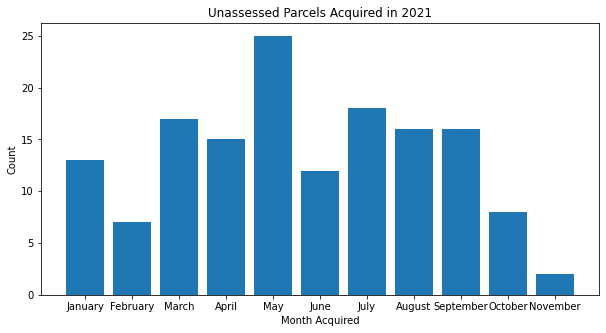

In [40]:
fig, ax = plt.subplots(figsize = (10,5))
plt.bar(unassessed_DateAcq_grouped_m.MonthAcquired, unassessed_DateAcq_grouped_m.OwnerName)
plt.xlabel('Month Acquired')
plt.ylabel('Count')
plt.title('Unassessed Parcels Acquired in 2021');

In [72]:
# DO NOT RUN AGAIN. Already been exported
# unassessed_DateAcq_grouped_m.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\unassessed_DateAcq_grouped_m.xlsx', index = False, header=True)

### Repeat above analysis for parcels acquired prior to 2021 grouped by year

In [43]:
unassessed_DateAcq_grouped_y = unassessed_DateAcq.groupby(pd.Grouper(key='Owner_DateAcquired', axis=0,freq='Y')).count()
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.reset_index()

In [44]:
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName
0,1987-12-31,1
1,1988-12-31,0
2,1989-12-31,0
3,1990-12-31,0
4,1991-12-31,0
5,1992-12-31,1
6,1993-12-31,0
7,1994-12-31,0
8,1995-12-31,0
9,1996-12-31,0


In [45]:
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.loc[unassessed_DateAcq_grouped_y.OwnerName >0]
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName
0,1987-12-31,1
5,1992-12-31,1
12,1999-12-31,1
15,2002-12-31,2
18,2005-12-31,1
20,2007-12-31,1
21,2008-12-31,1
24,2011-12-31,1
25,2012-12-31,2
26,2013-12-31,1


In [46]:
len(unassessed_DateAcq_grouped_y)

18

In [48]:
unassessed_DateAcq_grouped_y.columns

Index(['Owner_DateAcquired', 'OwnerName'], dtype='object')

In [49]:
unassessed_DateAcq_grouped_y['YearAcquired'] = unassessed_DateAcq_grouped_y['Owner_DateAcquired'].dt.year

C:\Users\Scott\AppData\Local\Temp/ipykernel_18748/2707328561.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  unassessed_DateAcq_grouped_y['YearAcquired'] = unassessed_DateAcq_grouped_y['Owner_DateAcquired'].dt.year


In [50]:
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName,YearAcquired
0,1987-12-31,1,1987
5,1992-12-31,1,1992
12,1999-12-31,1,1999
15,2002-12-31,2,2002
18,2005-12-31,1,2005
20,2007-12-31,1,2007
21,2008-12-31,1,2008
24,2011-12-31,1,2011
25,2012-12-31,2,2012
26,2013-12-31,1,2013


In [51]:
# Exclude 2021, previously analyzed by month
unassessed_DateAcq_grouped_y = unassessed_DateAcq_grouped_y.loc[unassessed_DateAcq_grouped_y.YearAcquired != 2021]
unassessed_DateAcq_grouped_y

,Owner_DateAcquired,OwnerName,YearAcquired
0,1987-12-31,1,1987
5,1992-12-31,1,1992
12,1999-12-31,1,1999
15,2002-12-31,2,2002
18,2005-12-31,1,2005
20,2007-12-31,1,2007
21,2008-12-31,1,2008
24,2011-12-31,1,2011
25,2012-12-31,2,2012
26,2013-12-31,1,2013


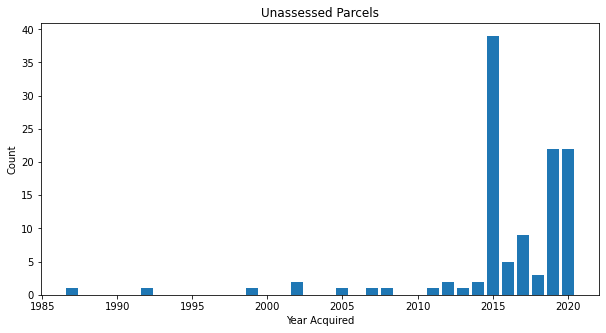

In [52]:
fig, ax = plt.subplots(figsize = (10,5))
plt.bar(unassessed_DateAcq_grouped_y.YearAcquired, unassessed_DateAcq_grouped_y.OwnerName)
plt.xlabel('Year Acquired')
plt.ylabel('Count')
plt.title('Unassessed Parcels');

In [53]:
# DO NOT RUN AGAIN. Already been exported
# unassessed_DateAcq_grouped_y.to_excel(r'C:\Users\Scott\My Documents\NSS\Capstone\slides\unassessed_DateAcq_grouped_y.xlsx', index = False, header=True)